In [80]:
from selenium import webdriver
from selenium.webdriver.common.by import By
from time import sleep
from selenium.webdriver.chrome.service import Service

S = Service('C:/Users/User/Desktop/chromedriver.exe')

driver = webdriver.Chrome(service = S)

# Open the target URL
driver.get("https://www.ambitionbox.com/list-of-companies?campaign=desktop_nav&page=1")

# Variable to store HTML content
all_html = ""

# Get the page source (HTML) of the initial page (page 1)
page_html = driver.page_source
all_html += page_html + "\n\n"

# Loop through page numbers from 2 to 301
for page_num in range(2,51):
    # Locate the link with the text equal to the current page number
    link = driver.find_element(By.LINK_TEXT, str(page_num))
    
    # Click the link
    link.click()
    
    # Wait for a short period to allow the page to load
    sleep(2)
    
    # Get the page source (HTML)
    page_html = driver.page_source
    
    # Append the HTML content to the all_html string
    all_html += page_html + "\n\n"

# Save the combined HTML to a file
with open("all_pagesP7.html", "w", encoding="utf-8") as file:
    file.write(all_html)

In [60]:
import pandas as pd
from bs4 import BeautifulSoup

In [81]:
with open('all_pagesP1.html', 'r', encoding='utf-8') as file:
    combined_html = file.read()

'<html lang="en" class="nprogress-busy" style="--vh: 6.51px;"><head>\n    <meta charset="UTF-8">\n    <meta name="viewport" content="width=device-width,initial-scale=1,minimum-scale=1">\n    <meta http-equiv="X-UA-Compatible" content="IE=edge"> \n    <style>@media only screen and (min-width:767px){.trp-img{width:400px!important;max-width:400px!important}}</style>\n    <script>window.dataLayer=window.dataLayer||[],window.gtag=window.gtag||function(){window.dataLayer.push(arguments)},gtag("js",new Date),window.initialDate=(new Date).toISOString()</script>\n    <script type="text/partytown">\n      window.dataLayer = window.dataLayer || [];\n      window.gtag = function() {\n      \twindow.dataLayer.push(arguments);\n      };\n      gtag(\'js\', new Date(window.initialDate));\n    </script>\n    <title>List of companies in India | AmbitionBox</title><meta data-n-head="ssr" name="copyright" content="2024 AmbitionBox"><meta data-n-head="ssr" name="revisit-after" content="1 day"><meta data-n
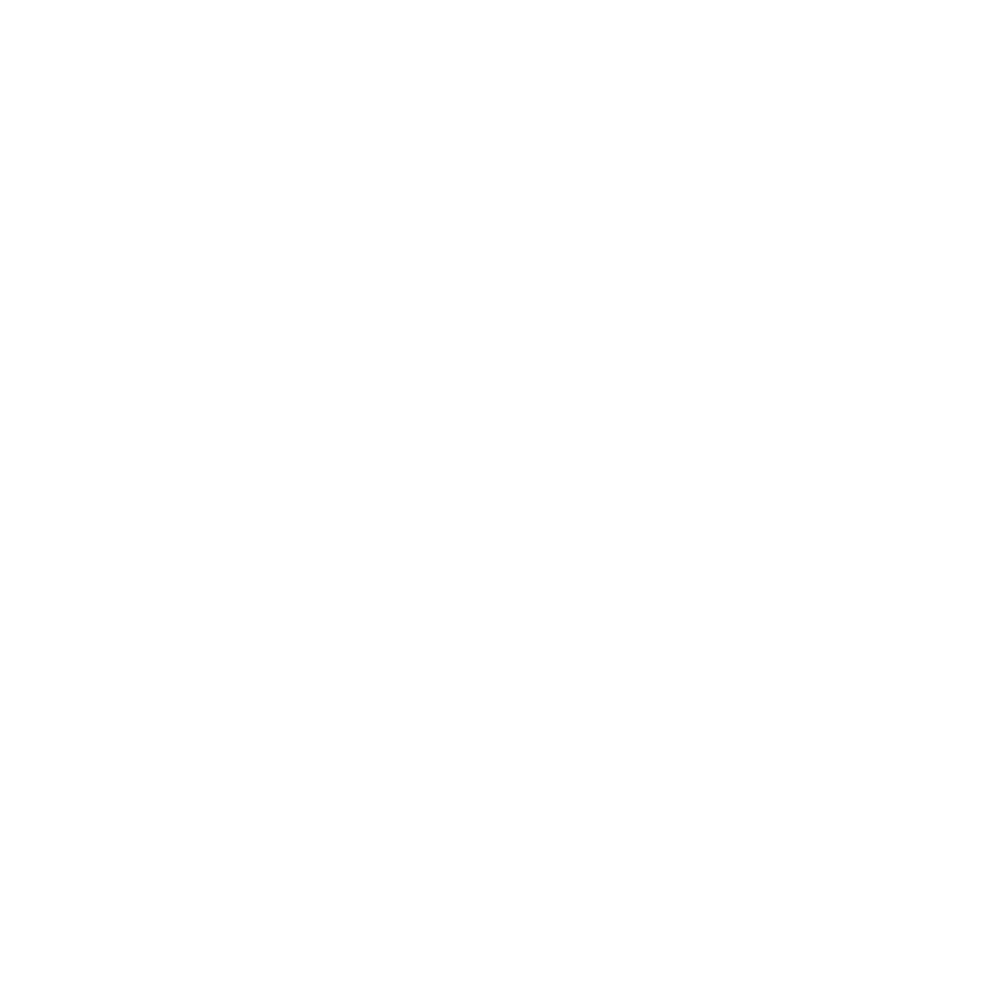
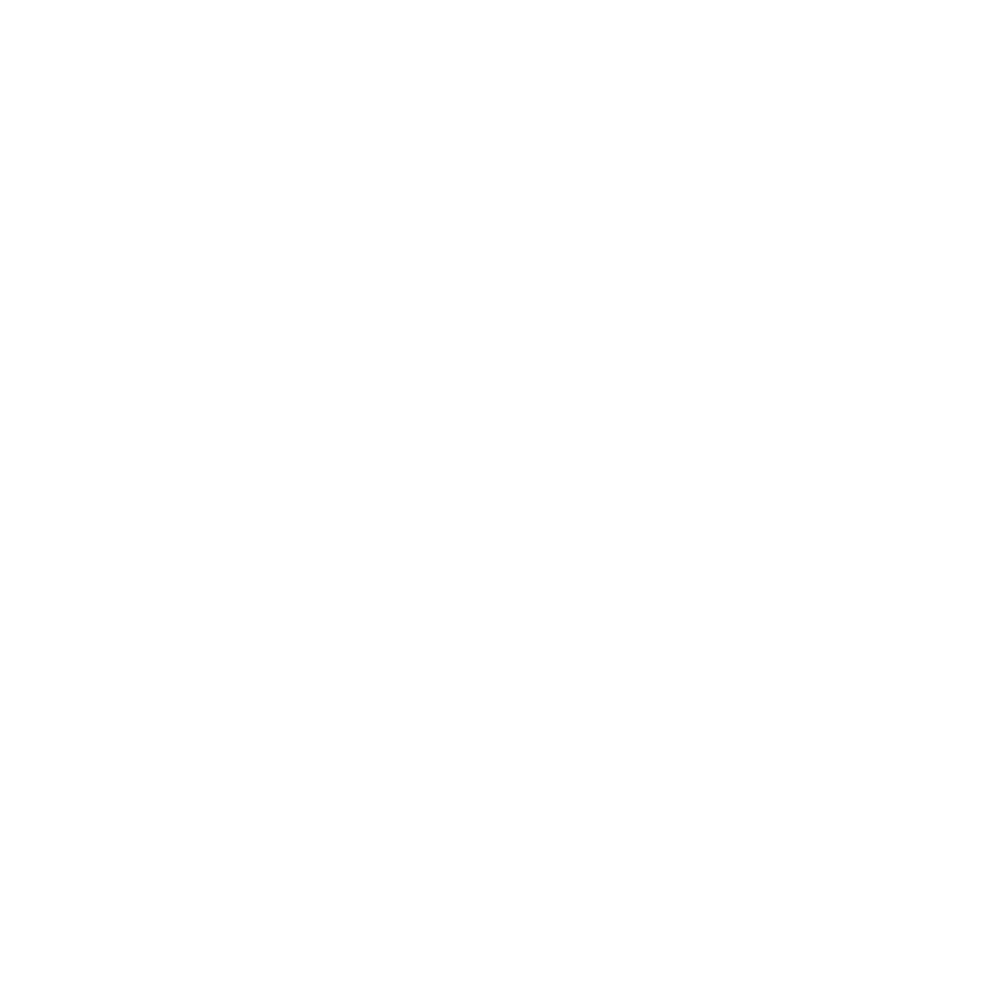
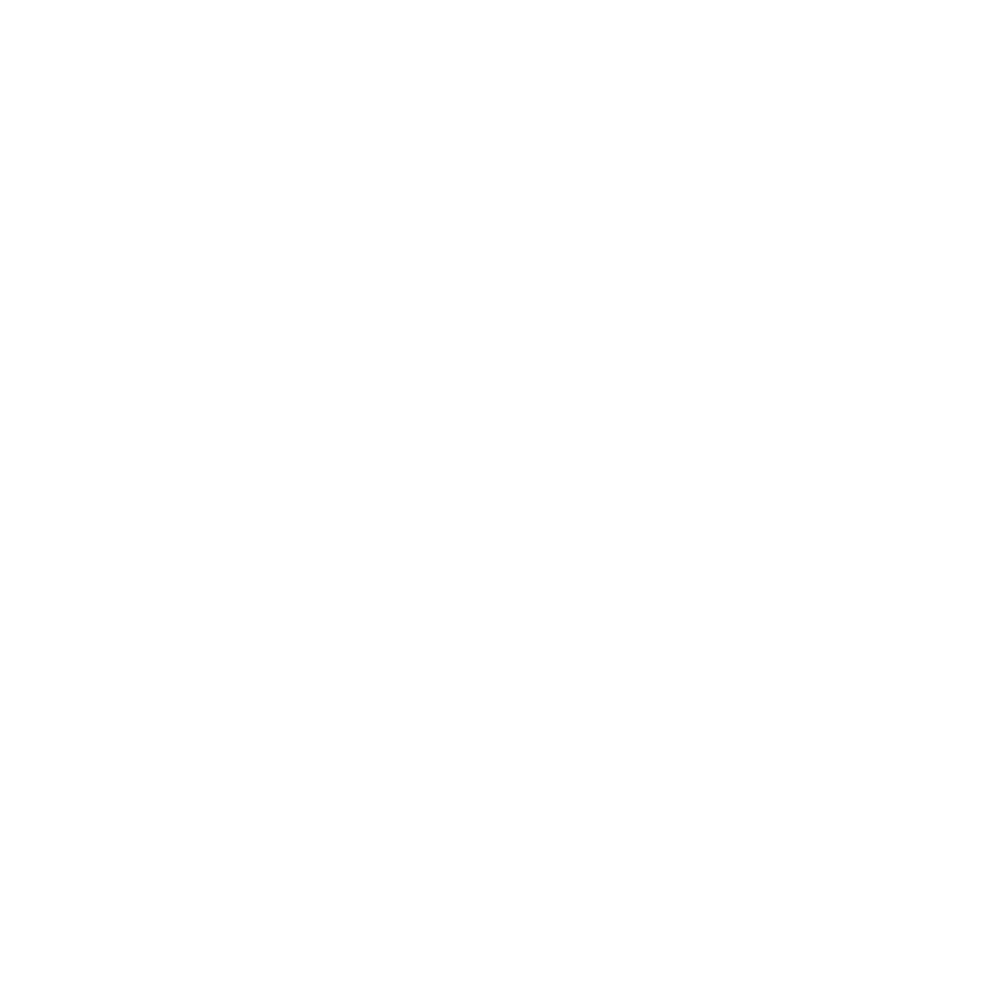
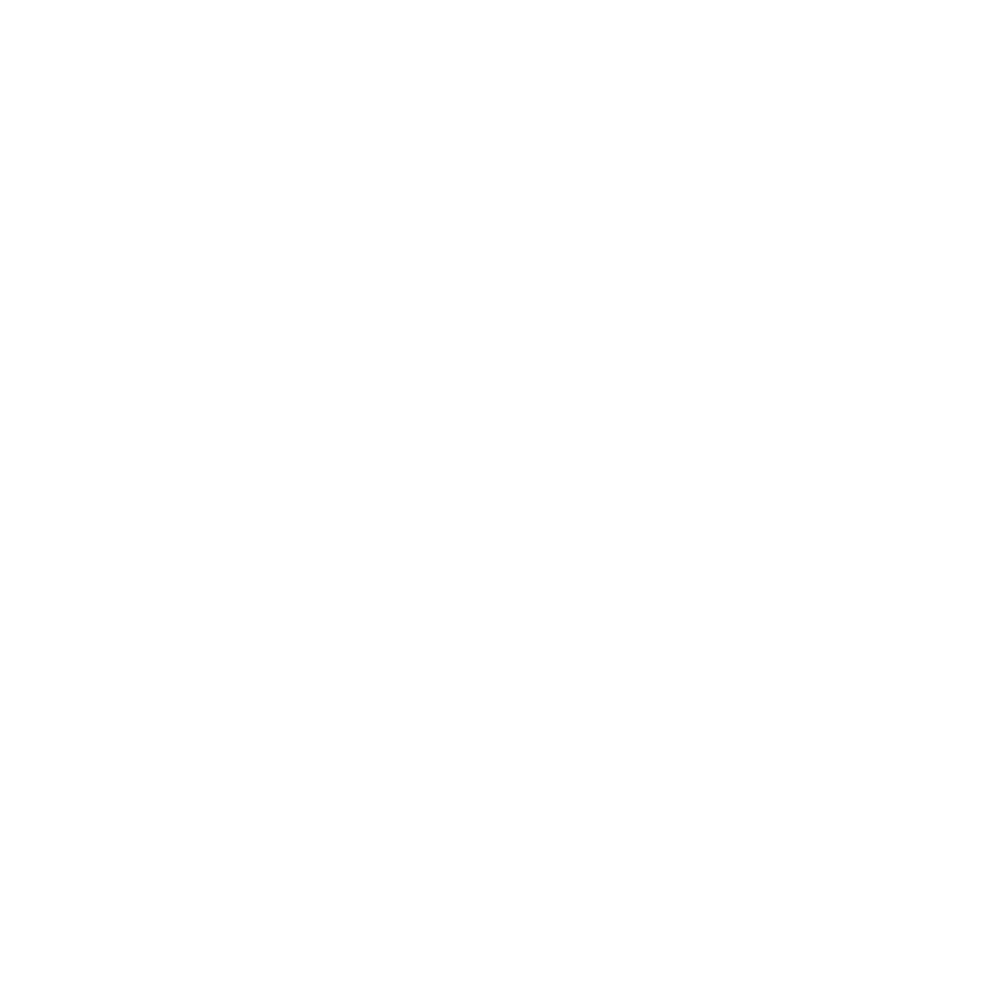
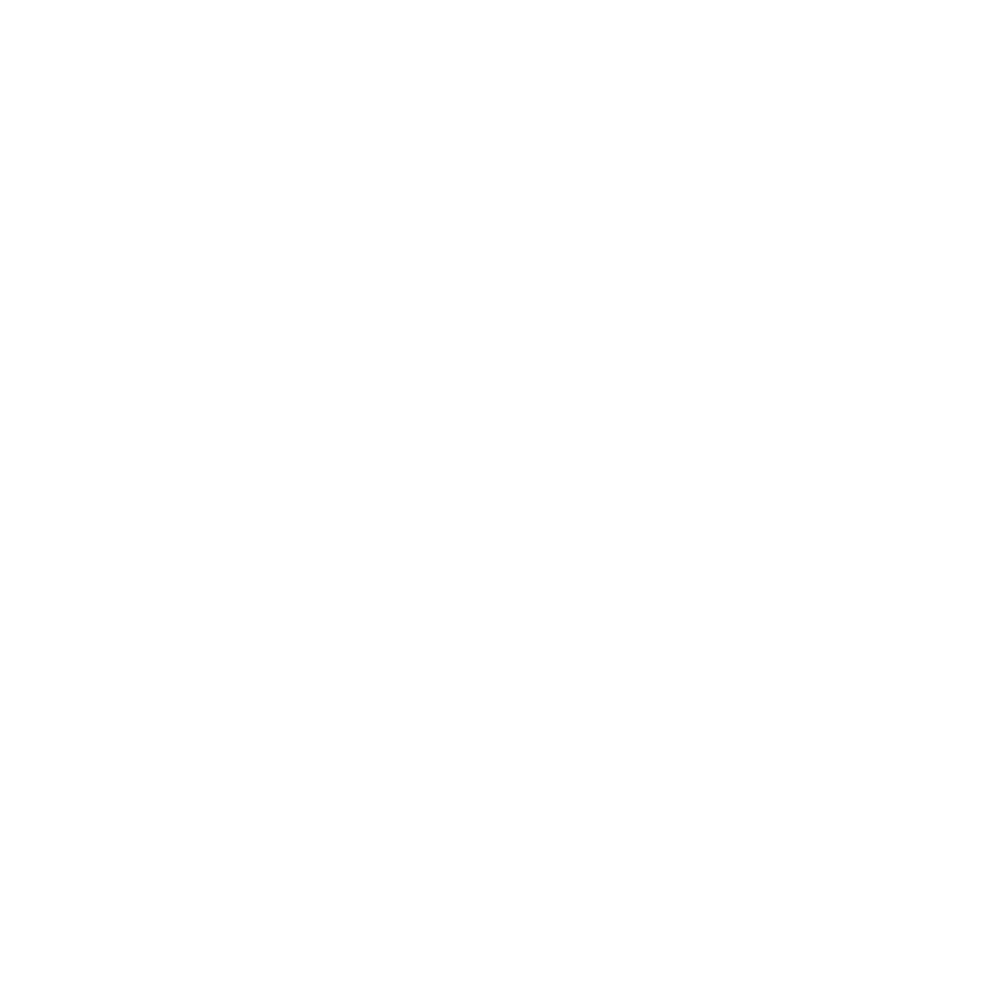
...
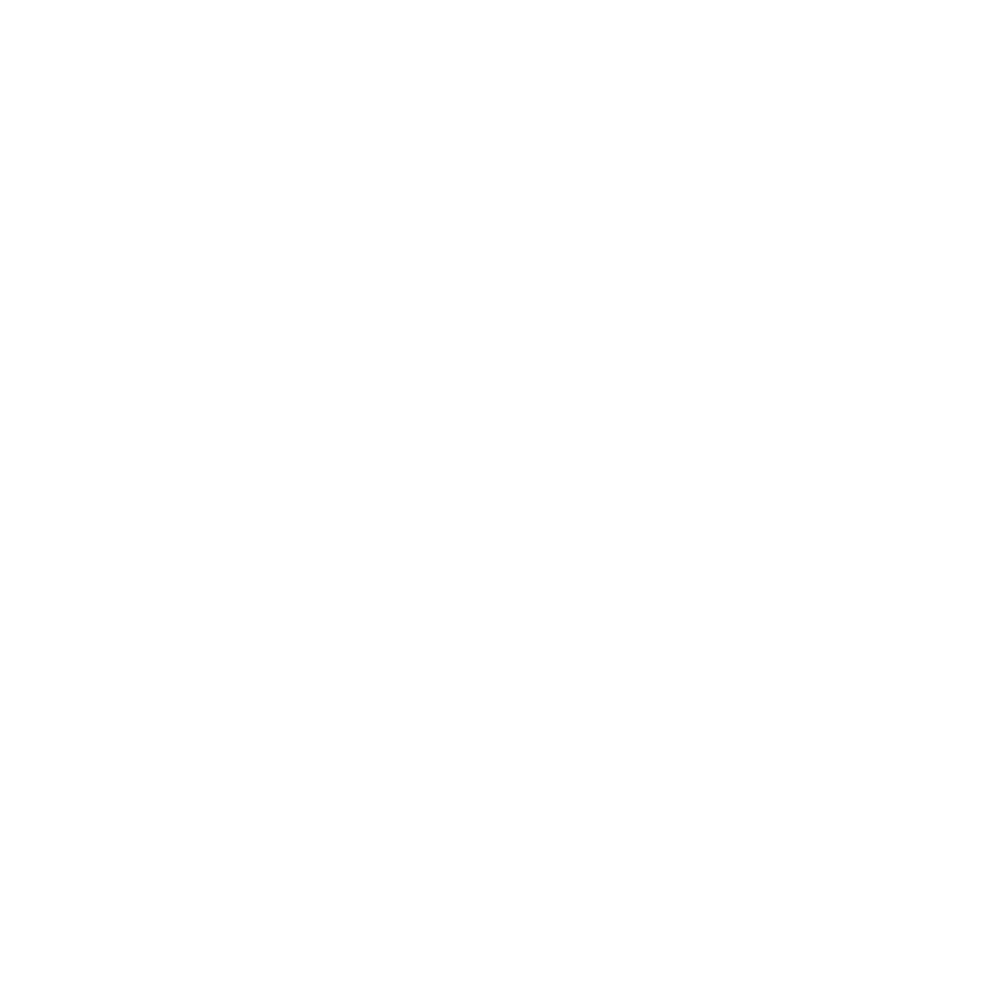
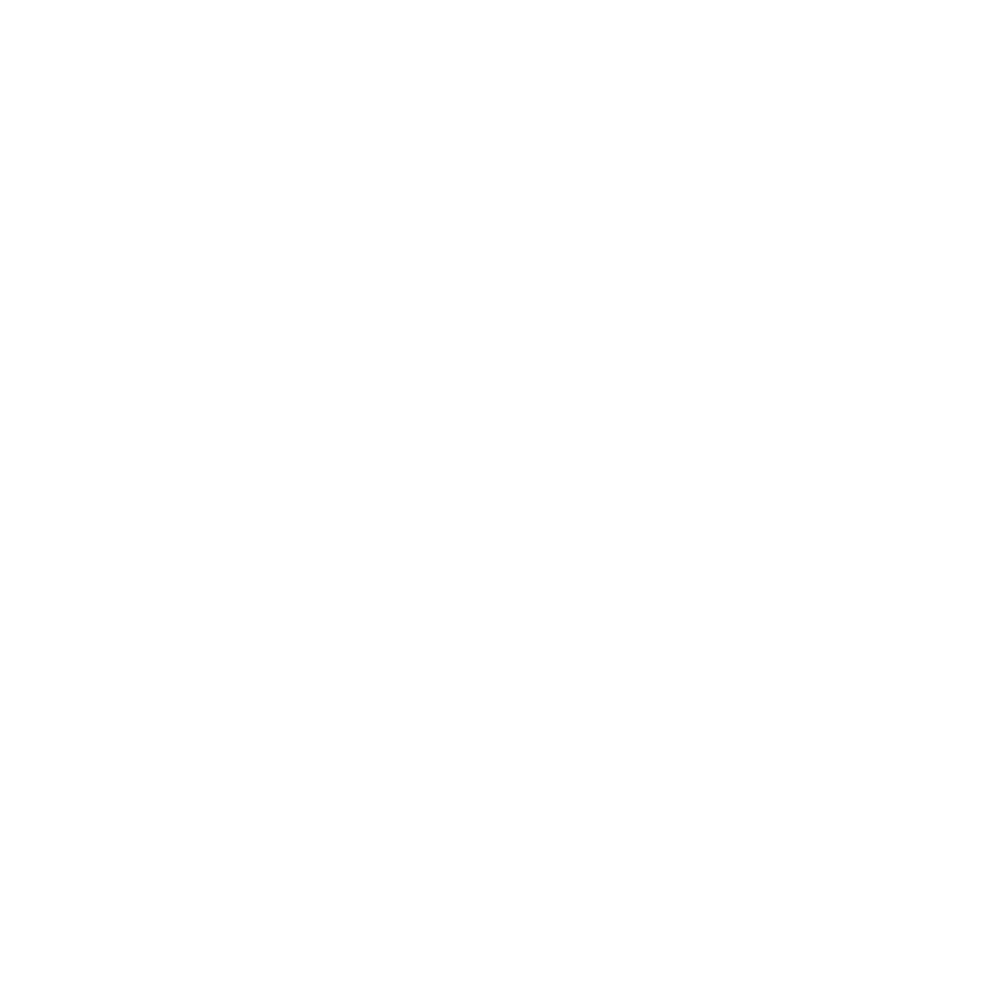
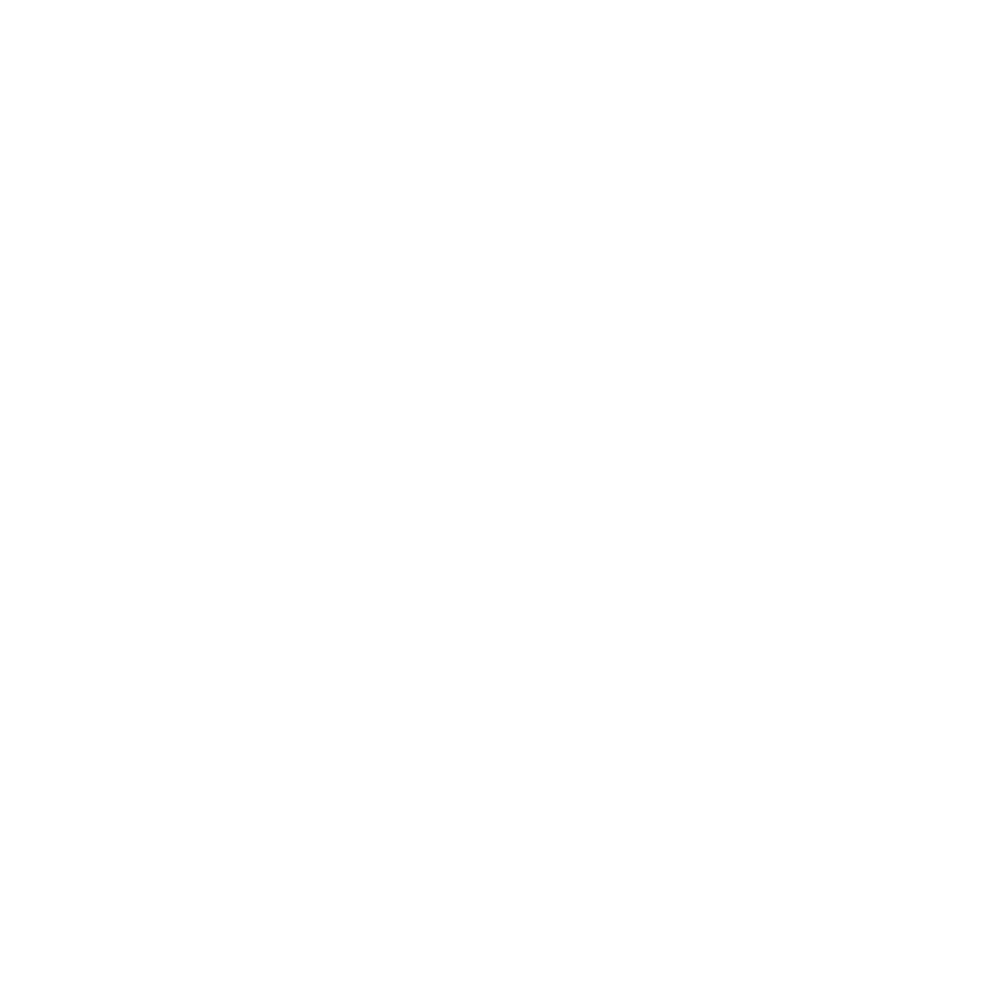
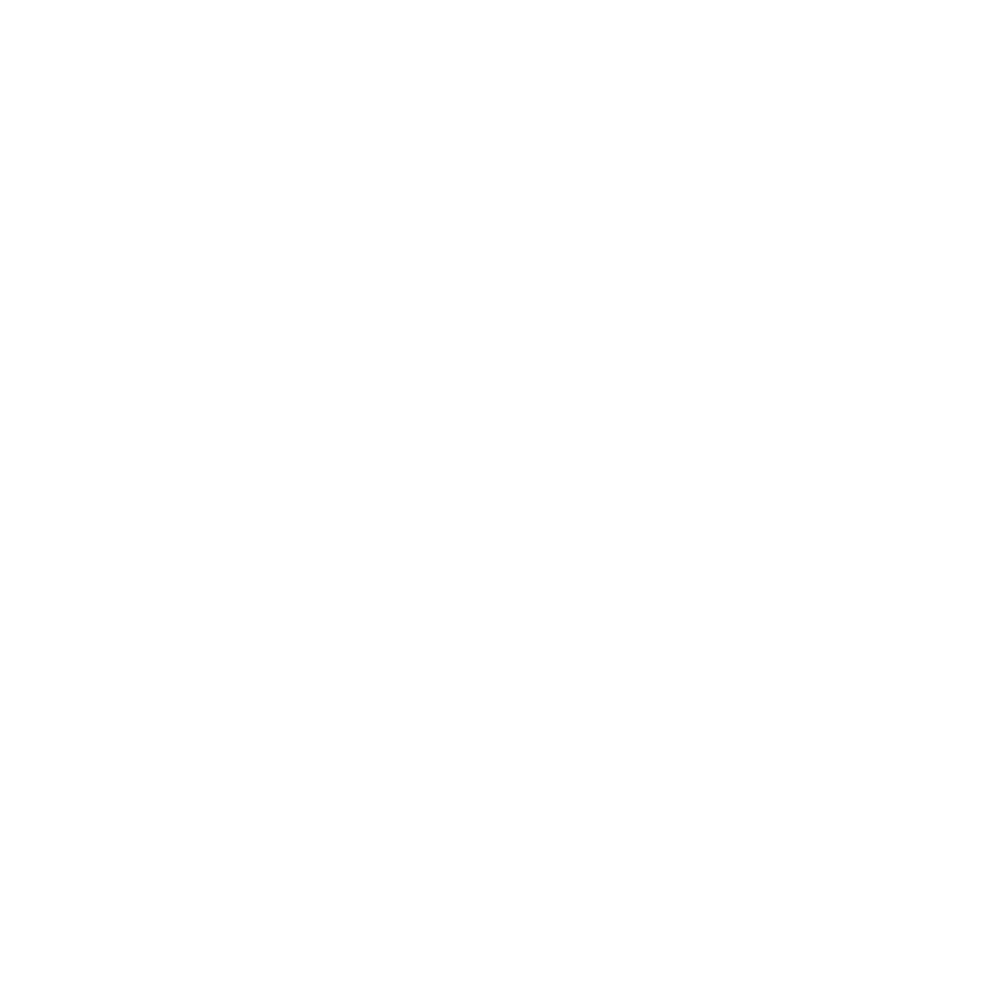
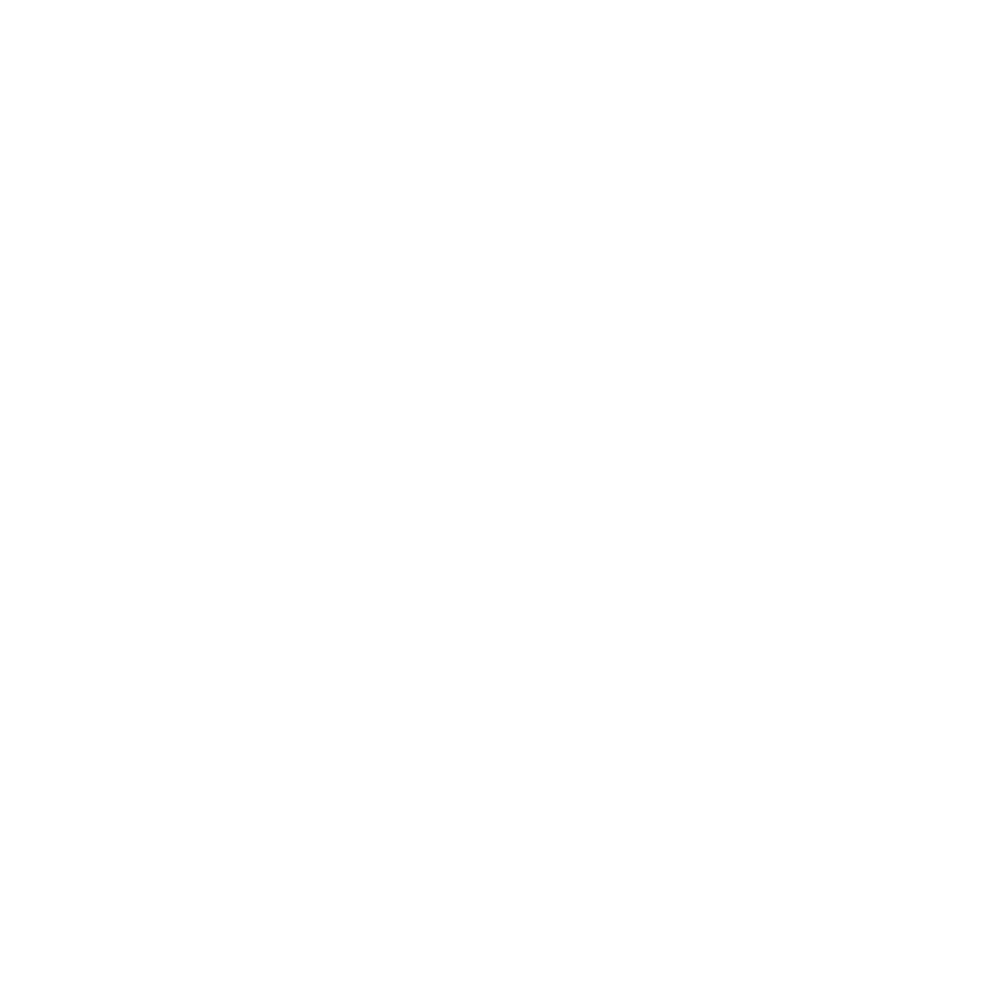

In [67]:
combined_html

In [82]:
soup=BeautifulSoup(combined_html,'html.parser')
box=soup.find_all('div',class_='companyCardWrapper')

In [83]:
Name = []
Info = []
Ratings = []
Highly_rated_for = []
Critically_rated_for = []
No_of_Reviews = []

for i in box:
    Name.append(i.find('h2', class_='companyCardWrapper__companyName').text.strip())
    Info.append(i.find('span', class_='companyCardWrapper__interLinking').text.strip())
    Ratings.append(i.find('span', class_='companyCardWrapper__companyRatingValue').text.strip())

    # Initialize variables to store ratings
    highly_rated_text = None
    critically_rated_text = None

    # Loop through each 'div' with class 'companyCardWrapper__ratingHeader' to find ratings
    for div in i.find_all('div', class_='companyCardWrapper__ratingHeader'):
        if 'Highly Rated For' in div.get_text():
            highly_rated_text = div.find_next('span', class_='companyCardWrapper__ratingValues').text.strip()
        elif 'Critically Rated For' in div.get_text():
            critically_rated_text = div.find_next('span', class_='companyCardWrapper__ratingValues').text.strip()

    Highly_rated_for.append(highly_rated_text)
    Critically_rated_for.append(critically_rated_text)
    
    No_of_Reviews.append(i.find('span', class_='companyCardWrapper__ActionCount').text.strip())
    

# Create a DataFrame
data = {
    "Name": Name,
    "Info": Info,
    "Ratings": Ratings,
    "Highly_rated_for": Highly_rated_for,
    "Critically_rated_for": Critically_rated_for,
    "Number_of_Voters":  No_of_Reviews
}

df = pd.DataFrame(data)

# Display the DataFrame
df

,Name,Info,Ratings,Highly_rated_for,Critically_rated_for,Number_of_Voters
0,Eka Software Solutions,IT Services & Consulting | 501-1k Employees | ...,3.5,None,"Job Security, Promotions / Appraisal, Company ...",94
1,Eben Telecom,Telecom | 501-1k Employees | 29 years old | Ko...,3.5,None,"Salary & Benefits, Promotions / Appraisal, Wor...",94
2,Site Engineering,Engineering & Construction | 10k-50k Employees...,3.9,"Work Life Balance, Company Culture",None,94
3,KTM,Automobile | 1k-5k Employees | 71 years old | ...,3.8,Skill Development / Learning,Promotions / Appraisal,94
4,LS Cable,Electrical Equipment | 51-200 Employees | Publ...,4.4,"Company Culture, Work Life Balance, Salary & B...",None,94
...,...,...,...,...,...,...
955,New Horizon College of Engineering,Education & Training | 201-500 Employees | 23 ...,3.4,None,"Promotions / Appraisal, Company Culture, Work ...",84
956,Appco Group,Marketing & Advertising | 501-1k Employees (Gl...,3.7,Skill Development / Learning,None,83
957,Alacrity Ecommerce Solutions Private Limited,IT Services & Consulting | 201-500 Employees |...,3.5,None,"Promotions / Appraisal, Skill Development / Le...",83
958,Data Template Infotech,IT Services & Consulting | 201-500 Employees |...,3.2,None,"Promotions / Appraisal, Salary & Benefits, Job...",83


In [9]:
df

,Name,Info,Ratings,Highly_rated_for,Critically_rated_for,Number_of_Voters
0,TCS,IT Services & Consulting | 1 Lakh+ Employees |...,3.8,"Job Security, Work Life Balance","Promotions / Appraisal, Salary & Benefits, Wor...",78.3k
1,Accenture,IT Services & Consulting | 1 Lakh+ Employees |...,4.0,"Company Culture, Skill Development / Learning,...",Promotions / Appraisal,48.8k
2,Cognizant,IT Services & Consulting | 1 Lakh+ Employees |...,3.9,Skill Development / Learning,Promotions / Appraisal,44.1k
3,Wipro,IT Services & Consulting | 1 Lakh+ Employees |...,3.8,Job Security,"Promotions / Appraisal, Salary & Benefits",41.9k
4,Capgemini,IT Services & Consulting | 1 Lakh+ Employees |...,3.8,"Job Security, Work Life Balance, Skill Develop...","Promotions / Appraisal, Salary & Benefits",36.1k
...,...,...,...,...,...,...
995,Pernod Ricard,Beverage | 1k-5k Employees | Forbes Global 200...,3.9,Salary & Benefits,Promotions / Appraisal,734
996,Centre for Development of Advanced Computing,IT Services & Consulting | 1k-5k Employees | 3...,3.9,"Job Security, Work Life Balance","Promotions / Appraisal, Salary & Benefits",732
997,Patra Corporation,BPO | 1k-5k Employees | 19 years old | Visakha...,3.8,"Job Security, Company Culture","Salary & Benefits, Promotions / Appraisal",732
998,Salesforce,Software Product | 5k-10k Employees | Public |...,4.1,"Salary & Benefits, Work Life Balance, Company ...",None,730


In [15]:
df2

,Name,Info,Ratings,Highly_rated_for,Critically_rated_for,Number_of_Voters
0,HFCL,Hardware & Networking | 1k-5k Employees | Publ...,4.2,"Work Life Balance, Job Security, Skill Develop...",None,729
1,Intex Technologies,Consumer Electronics & Appliances | 1k-5k Empl...,3.7,None,"Job Security, Promotions / Appraisal, Company ...",728
2,Better.com,Financial Services | 1k-5k Employees | Startup...,3.1,Salary & Benefits,"Job Security, Skill Development / Learning, Pr...",728
3,Indira IVF Hospital,Healthcare | 1k-5k Employees | 9 years old | M...,3.9,"Skill Development / Learning, Salary & Benefits",None,726
4,TNQ Technologies,Printing & Publishing | 1k-5k Employees | 26 y...,3.6,None,"Promotions / Appraisal, Salary & Benefits, Ski...",725
...,...,...,...,...,...,...
1015,Ess Kay Fincorp,NBFC | 5k-10k Employees | Public | 30 years ol...,4.1,"Company Culture, Skill Development / Learning,...",None,377
1016,Innominds Software,IT Services & Consulting | 1k-5k Employees | 2...,3.1,None,"Promotions / Appraisal, Job Security, Salary &...",377
1017,PayU Payments,FinTech | 1k-5k Employees | Conglomerate | 22 ...,3.7,None,"Promotions / Appraisal, Job Security, Work Sat...",377
1018,Satyam Venture Engineering Services,Auto Components | 1k-5k Employees | 24 years o...,3.9,"Job Security, Work Life Balance",None,377


In [35]:
df3

,Name,Info,Ratings,Highly_rated_for,Critically_rated_for,Number_of_Voters
0,H & R Johnson,Building Material | 1k-5k Employees | 28 years...,3.8,None,Promotions / Appraisal,376
1,Hpl Electric & Power,Electrical Equipment | 1k-5k Employees | 32 ye...,3.6,None,"Promotions / Appraisal, Salary & Benefits, Com...",376
2,Creative Synergies Group,IT Services & Consulting | 501-1k Employees | ...,4.1,"Company Culture, Salary & Benefits, Work Life ...",None,376
3,Accion Labs,IT Services & Consulting | 1k-5k Employees | 1...,3.7,None,"Promotions / Appraisal, Job Security, Work Sat...",376
4,Vijai Electricals,Power | 5k-10k Employees | 51 years old | Hyde...,3.7,Skill Development / Learning,"Promotions / Appraisal, Salary & Benefits, Com...",375
...,...,...,...,...,...,...
995,Flipkart Wholesale,11-50 Employees | Bangalore / Bengaluru +52 more,4.0,"Salary & Benefits, Company Culture",None,257
996,Labcorp,Healthcare | 501-1k Employees | Forbes Global ...,4.1,"Job Security, Company Culture, Work Life Balance",None,257
997,Personiv,BPO | 1k-5k Employees | 39 years old | Austin ...,3.7,None,Promotions / Appraisal,256
998,Amartex Industries,Fashion & Textile | 51-200 Employees | Public ...,4.3,"Skill Development / Learning, Salary & Benefit...",None,256


In [73]:
df4

,Name,Info,Ratings,Highly_rated_for,Critically_rated_for,Number_of_Voters
0,Pharmaceutical job,Pharma | Paris +51 more,4.0,"Skill Development / Learning, Work Satisfactio...",None,152
1,"Sanjay Ghodawat International School, Kolhapur",Education & Training | 201-500 Employees | 14 ...,2.4,None,"Job Security, Work Life Balance, Work Satisfac...",152
2,Advantum Health,Healthcare | 201-500 Employees | 28 years old ...,3.6,None,"Promotions / Appraisal, Salary & Benefits, Ski...",152
3,Asiana Times,Media & Entertainment | 51-200 Employees | Nag...,4.4,"Work Life Balance, Skill Development / Learnin...",Salary & Benefits,152
4,Gyansys Infotech,IT Services & Consulting | 201-500 Employees |...,3.1,None,"Company Culture, Skill Development / Learning,...",152
...,...,...,...,...,...,...
1015,Holy Family Hospital,Healthcare | 1k-5k Employees | 71 years old | ...,4.0,"Skill Development / Learning, Job Security",Promotions / Appraisal,127
1016,Ishan Technologies,Internet | 1k-5k Employees | 24 years old | Ah...,3.9,"Company Culture, Skill Development / Learning",None,127
1017,Careers360,Education & Training | 201-500 Employees | 16 ...,3.1,None,"Promotions / Appraisal, Work Satisfaction, Ski...",127
1018,Texport Industries,Fashion & Textile | 1k-5k Employees | 46 years...,3.8,None,"Promotions / Appraisal, Salary & Benefits, Com...",127


In [79]:
df5

,Name,Info,Ratings,Highly_rated_for,Critically_rated_for,Number_of_Voters
0,Smart Call Center Solutions,BPO | 11-50 Employees | 9 years old | Kolkata ...,3.2,None,"Promotions / Appraisal, Salary & Benefits, Wor...",109
1,eSense Learning,EdTech | 201-500 Employees | 16 years old | Mu...,3.9,None,"Promotions / Appraisal, Salary & Benefits, Ski...",104
2,Al Naboodah,Engineering & Construction | 10k-50k Employees...,4.7,"Work Satisfaction, Company Culture, Work Life ...",None,103
3,Logelite,Software Product | 51-200 Employees | 4 years ...,4.7,"Company Culture, Work Life Balance, Work Satis...",None,129
4,Urbanpro,EdTech | 51-200 Employees | 13 years old | Ban...,3.6,None,"Promotions / Appraisal, Salary & Benefits, Job...",111
...,...,...,...,...,...,...
1015,MyCar,Automobile | 11-50 Employees | 19 years old | ...,3.9,"Skill Development / Learning, Company Culture","Job Security, Work Satisfaction, Salary & Bene...",94
1016,RATNATRIS PHARMACEUTICALS PRIVATE LIMITED,Pharma | 201-500 Employees | 13 years old | Ah...,3.9,"Job Security, Work Life Balance, Salary & Bene...",None,94
1017,Comau,Industrial Automation | 51-200 Employees | 27 ...,3.5,None,"Promotions / Appraisal, Company Culture, Work ...",94
1018,Eben Telecom,Telecom | 501-1k Employees | 29 years old | Ko...,3.5,None,"Salary & Benefits, Promotions / Appraisal, Wor...",94


In [84]:
df6

,Name,Info,Ratings,Highly_rated_for,Critically_rated_for,Number_of_Voters
0,Eka Software Solutions,IT Services & Consulting | 501-1k Employees | ...,3.5,None,"Job Security, Promotions / Appraisal, Company ...",94
1,Eben Telecom,Telecom | 501-1k Employees | 29 years old | Ko...,3.5,None,"Salary & Benefits, Promotions / Appraisal, Wor...",94
2,Site Engineering,Engineering & Construction | 10k-50k Employees...,3.9,"Work Life Balance, Company Culture",None,94
3,KTM,Automobile | 1k-5k Employees | 71 years old | ...,3.8,Skill Development / Learning,Promotions / Appraisal,94
4,LS Cable,Electrical Equipment | 51-200 Employees | Publ...,4.4,"Company Culture, Work Life Balance, Salary & B...",None,94
...,...,...,...,...,...,...
955,New Horizon College of Engineering,Education & Training | 201-500 Employees | 23 ...,3.4,None,"Promotions / Appraisal, Company Culture, Work ...",84
956,Appco Group,Marketing & Advertising | 501-1k Employees (Gl...,3.7,Skill Development / Learning,None,83
957,Alacrity Ecommerce Solutions Private Limited,IT Services & Consulting | 201-500 Employees |...,3.5,None,"Promotions / Appraisal, Skill Development / Le...",83
958,Data Template Infotech,IT Services & Consulting | 201-500 Employees |...,3.2,None,"Promotions / Appraisal, Salary & Benefits, Job...",83


In [86]:
df.to_csv('output1.csv', index=False)
df2.to_csv('output2.csv', index=False)
df3.to_csv('output3.csv', index=False)
df4.to_csv('output4.csv', index=False)
df5.to_csv('output5.csv', index=False)
df6.to_csv('output6.csv', index=False)